In [20]:
import tensorflow as tf
from tensorflow.keras import models, layers
import numpy as np
import matplotlib.pyplot as plt
import joblib
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
import numpy as np 
import joblib
from sklearn.model_selection import train_test_split


In [21]:
IMAGE_SIZE = 256
BATCH_SIZE = 32

dataset = tf.keras.preprocessing.image_dataset_from_directory(
    "PlantVillage",
    shuffle=True,
    image_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE
)


Found 3973 files belonging to 10 classes.


In [22]:
train_ds = dataset.take(54)
test_ds = dataset.skip(54)


In [23]:
resize_and_rescale = tf.keras.Sequential([
    tf.keras.layers.Resizing(IMAGE_SIZE, IMAGE_SIZE),
    tf.keras.layers.Rescaling(1.0/255)
])


In [24]:
total_batches = len(dataset)


In [25]:
train_percentage = 0.8

In [26]:
train_batches = int(train_percentage * total_batches)
test_batches = total_batches - train_batches

In [27]:
train_ds = dataset.take(train_batches)
test_ds = dataset.skip(train_batches)


In [28]:
X_train, y_train = [], []
for images, labels in train_ds:
    X_train.append(images.numpy())
    y_train.append(labels.numpy())
X_train = np.concatenate(X_train)
y_train = np.concatenate(y_train)

X_test, y_test = [], []
for images, labels in test_ds:
    X_test.append(images.numpy())
    y_test.append(labels.numpy())
X_test = np.concatenate(X_test)
y_test = np.concatenate(y_test)


In [29]:
base_classifier = DecisionTreeClassifier(max_depth=1)


In [30]:
adaboost_clf = AdaBoostClassifier(base_classifier, n_estimators=50)


In [31]:
adaboost_clf.fit(X_train.reshape(len(X_train), -1), y_train)


C:\Users\ADITYA\AppData\Roaming\Python\Python310\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=1))

In [32]:
train_accuracy = accuracy_score(y_train, adaboost_clf.predict(X_train.reshape(len(X_train), -1)))
test_accuracy = accuracy_score(y_test, adaboost_clf.predict(X_test.reshape(len(X_test), -1)))

print("Train Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)


Train Accuracy: 0.356875
Test Accuracy: 0.32470892626131953


In [33]:
num_images_training = len(X_train)
print("Number of images used for training:", num_images_training)


Number of images used for training: 3200


In [34]:
# Save the Model with filename "models.h1"
joblib.dump(adaboost_clf, 'models_adaboost.h1')


['models_adaboost.h1']

<Figure size 1300x1300 with 0 Axes>

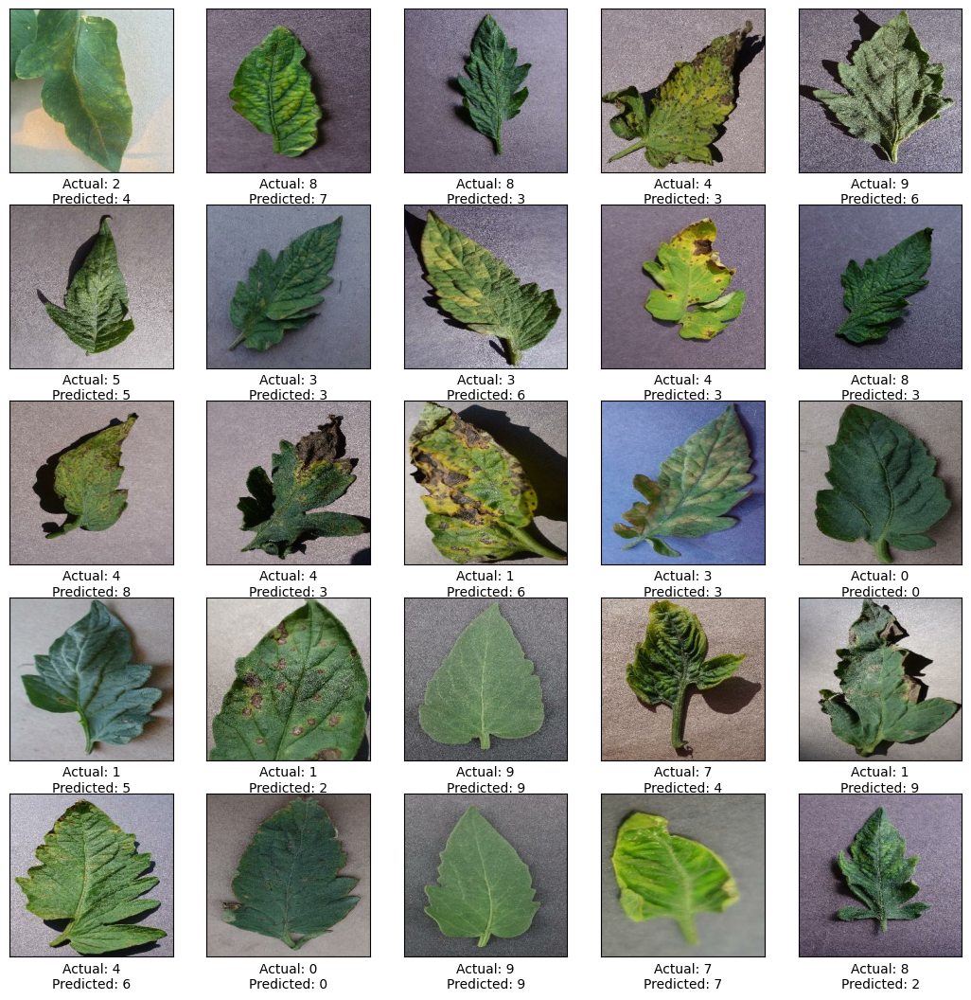

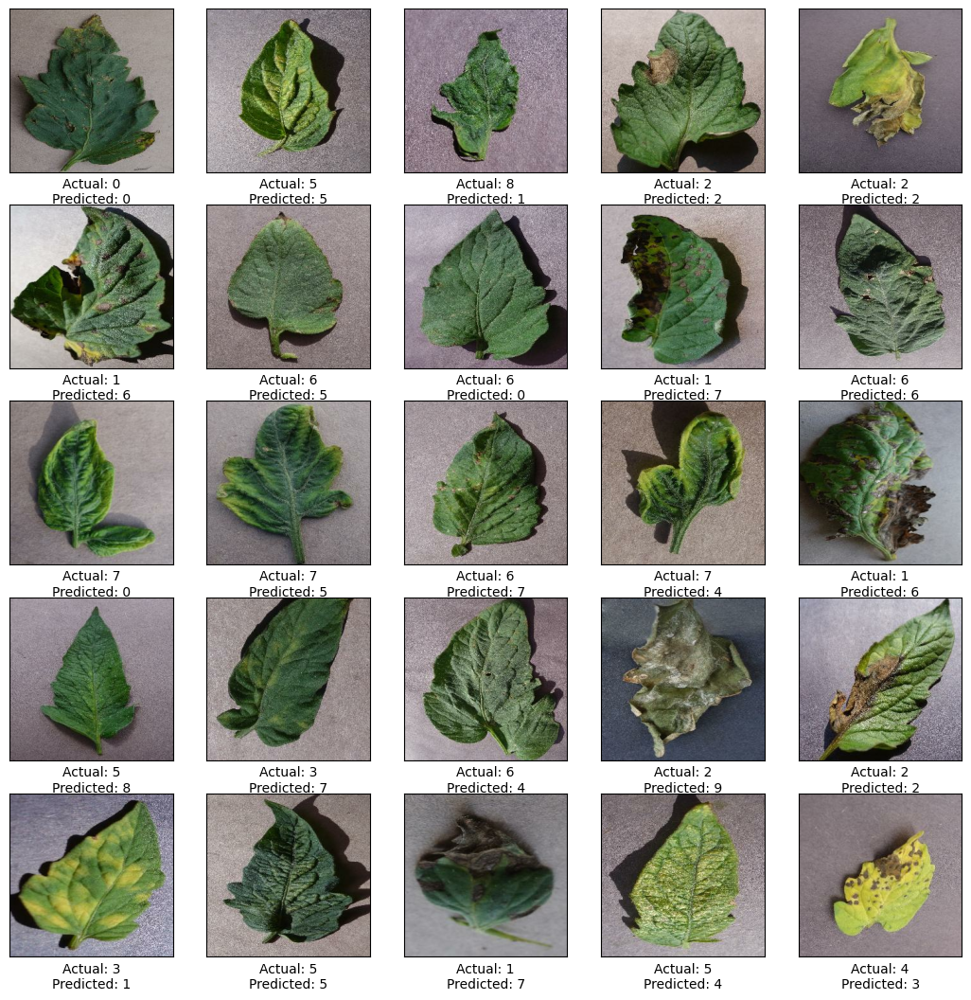

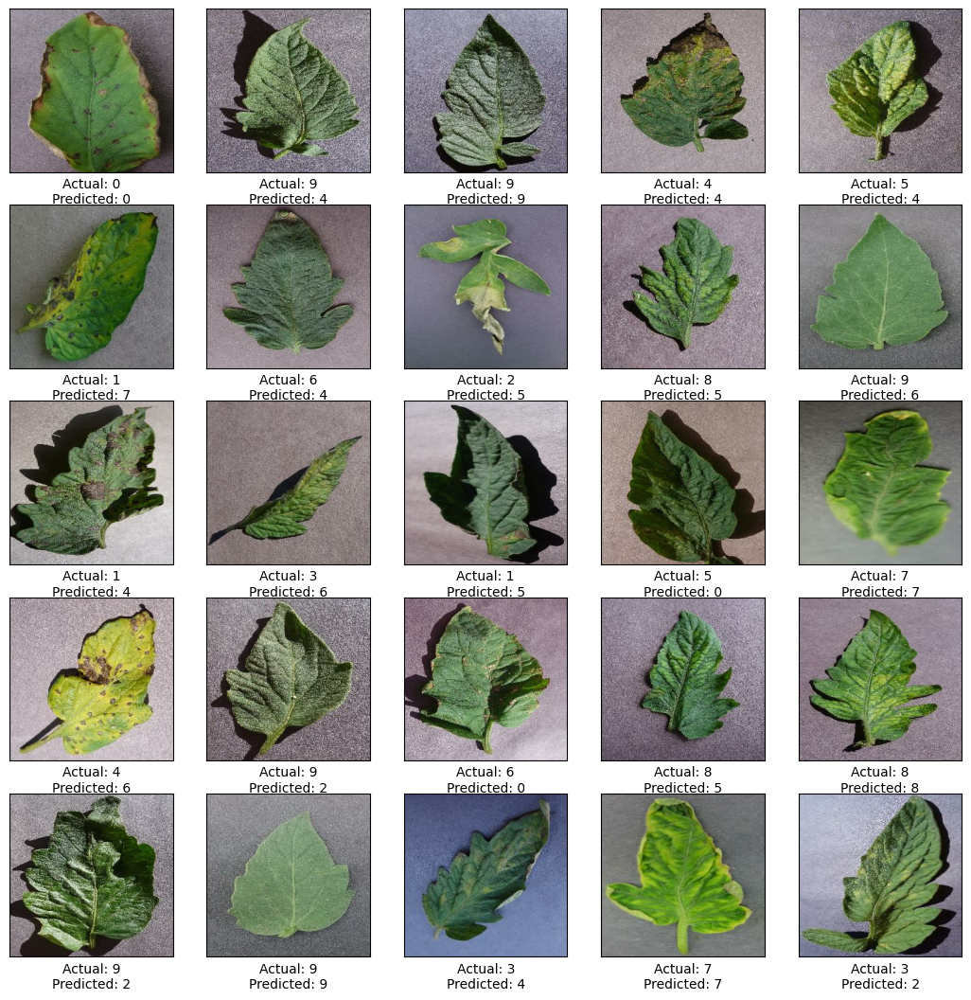

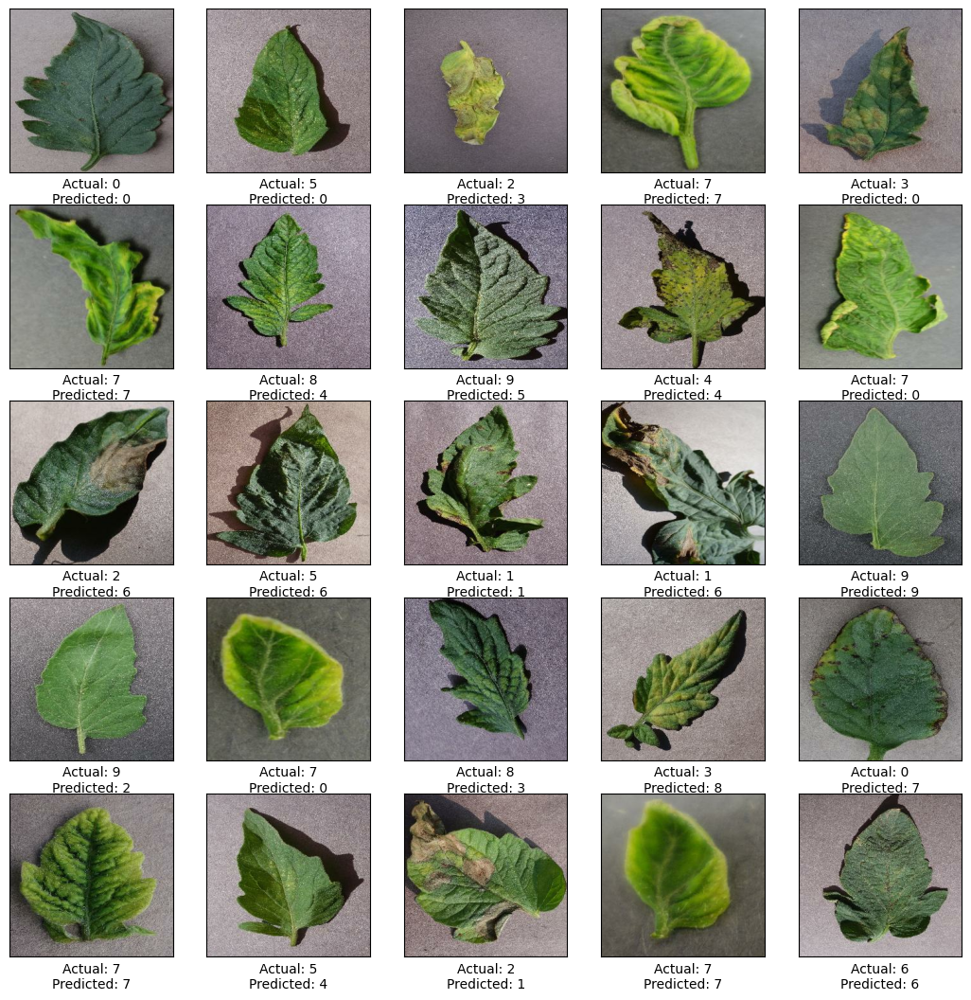

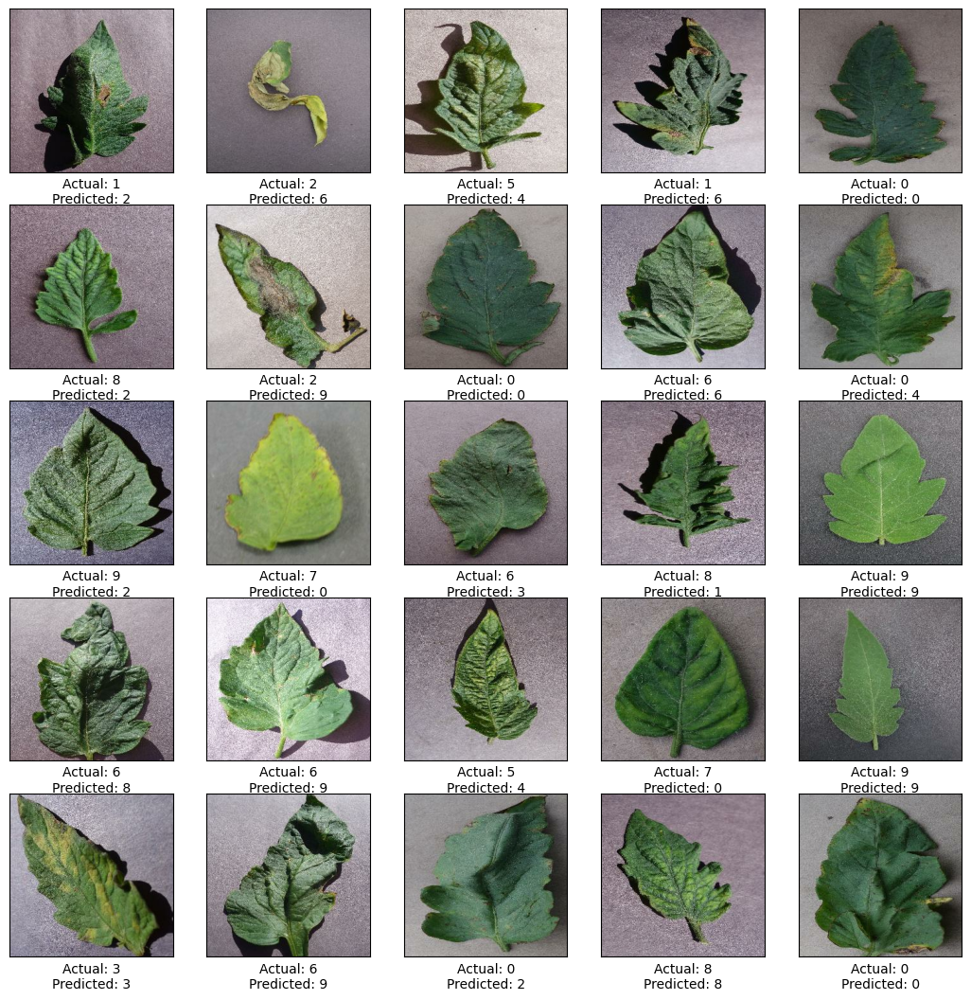

...

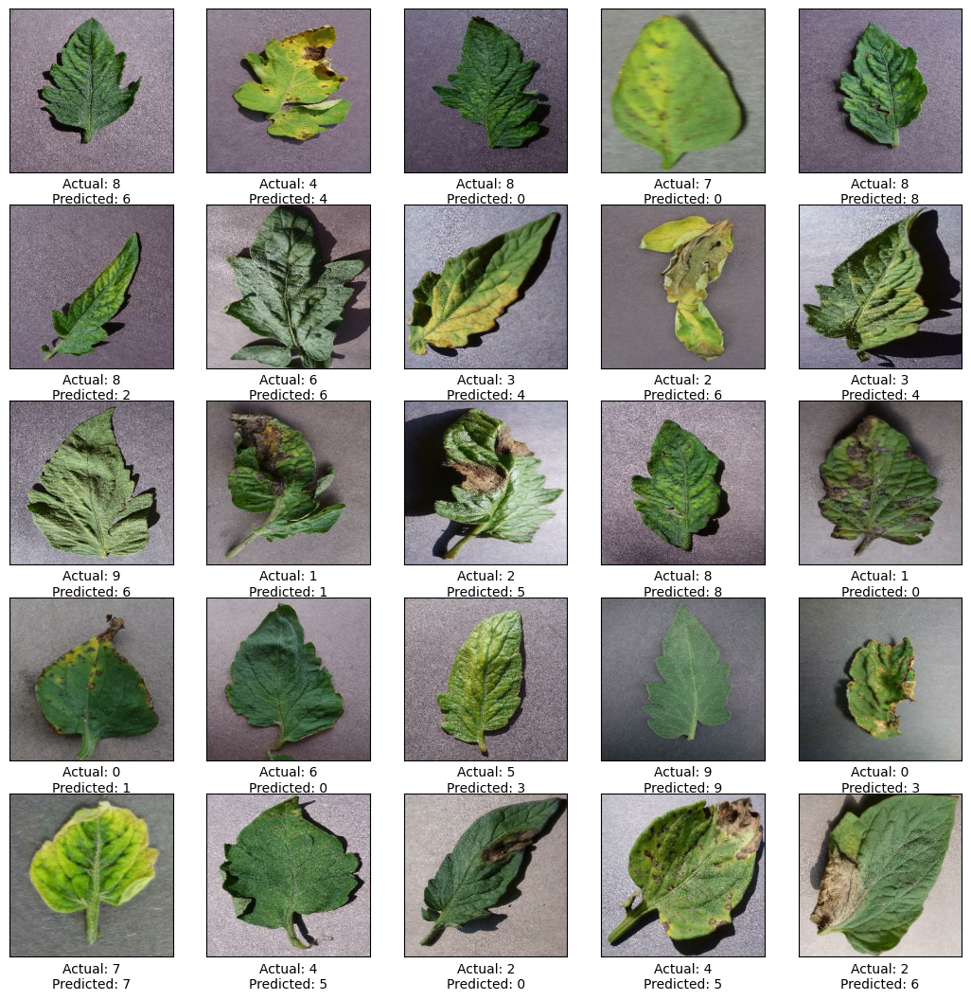

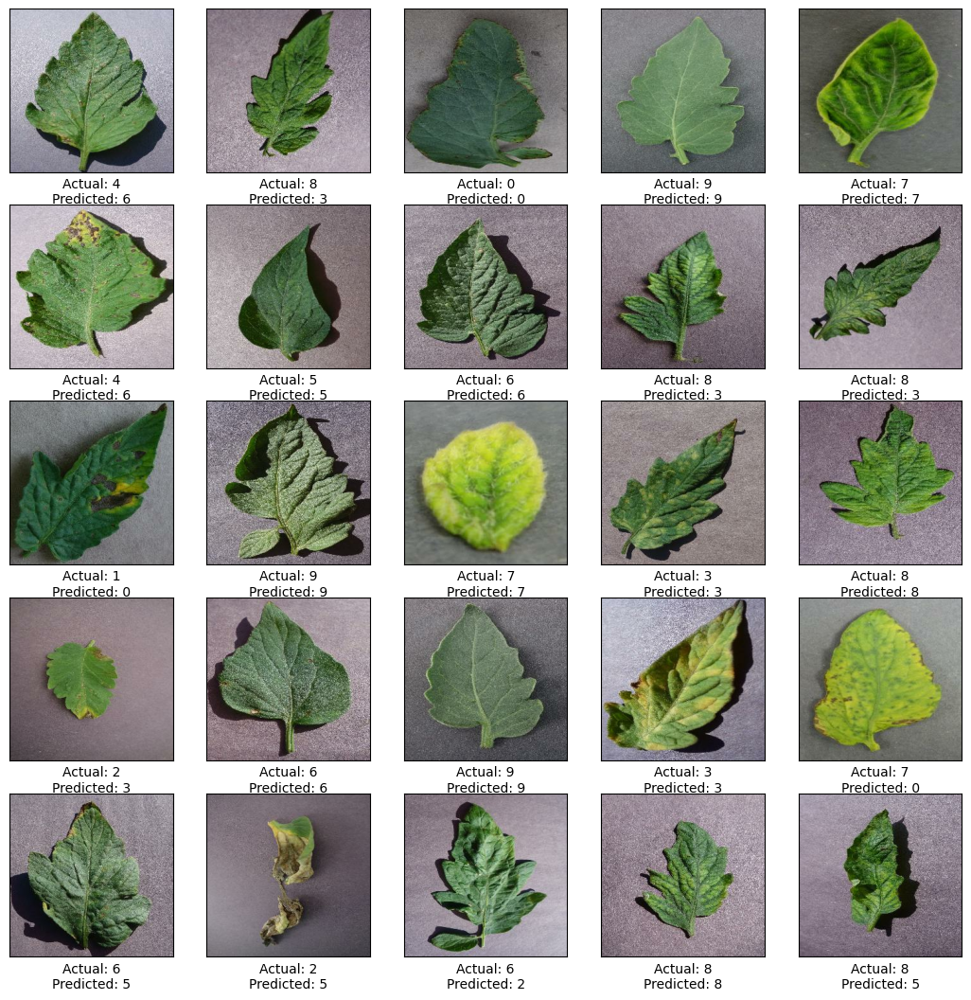

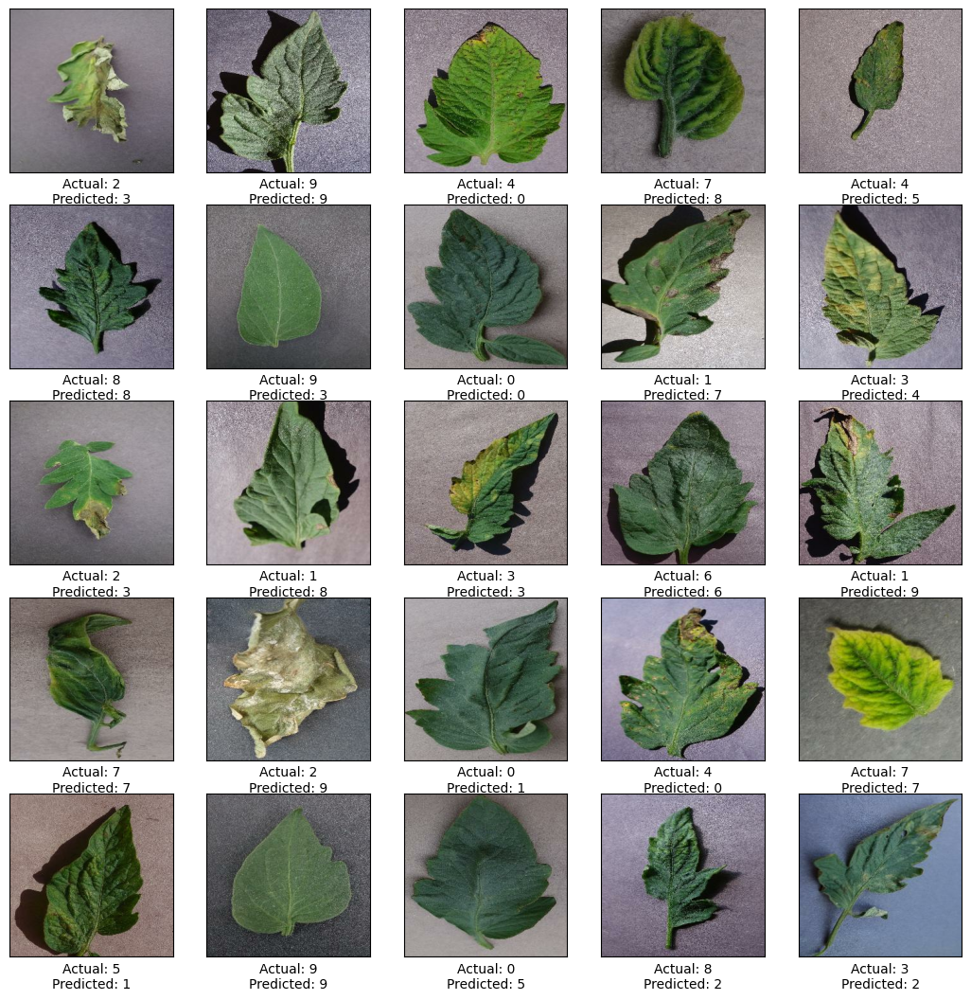

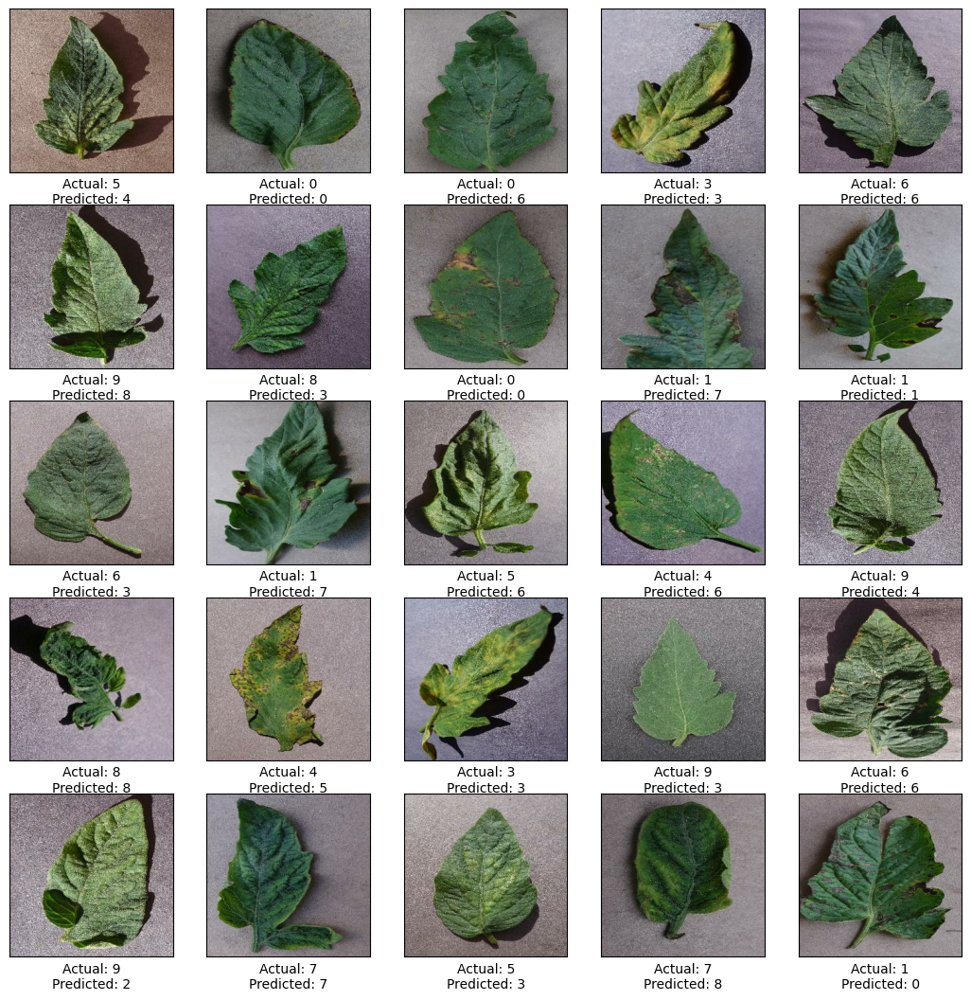

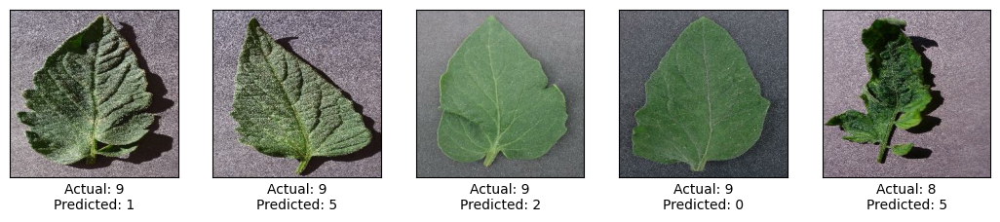

In [41]:
plt.figure(figsize=(13, 13))
for images, labels in test_ds:
    plt.figure(figsize=(13, 13))

    predictions = adaboost_clf.predict(images.numpy().reshape(len(images), -1))
    for i in range(min(len(images), 25)):
        plt.subplot(5, 5, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.xlabel(f'Actual: {labels[i].numpy()}\nPredicted: {predictions[i]}')
    plt.show()
